In [1]:
import os
import cv2
import glob
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.animation as animation


datapath = "data/KeioNIRCT/video_12031349/"
colorpath = datapath+"color/"
thermalpath = datapath+"thermal/"
nirpath = datapath+"nir/"

color_images = []
for image in glob.glob(colorpath+"*.png"):
    color_images.append(image)
color_images = sorted(color_images)    

thermal_images = []
for image in glob.glob(thermalpath+"*.png"):
    thermal_images.append(image)
thermal_images = sorted(thermal_images)    

nir_images = []
for image in glob.glob(nirpath+"*.png"):
    nir_images.append(image)
nir_images = sorted(nir_images)    

In [42]:
def crop_images(color, thermal, nir):

    y = 118 #198
    x = 413 #473
    h = 190
    w = 190

    cropcolor = color[y:y+h, x:x+w]

    y = 75 #150
    x = 201 #251

    resizethermal = cv2.resize(thermal,(580, 436)) #cv2.resize(thermal,(570, 428))
    cropthermal = resizethermal[y:y+h, x:x+w]

    resizenir = cv2.resize(nir, (190, 190))
    
    return cropcolor, cropthermal, resizenir

In [33]:
def crop_images_calib(color, thermal, nir):

    y = 178
    x = 488
    h = 190
    w = 190

    cropcolor = color[y:y+h, x:x+w]

    y = 130
    x = 265

    resizethermal = cv2.resize(thermal,(570, 428))
    cropthermal = resizethermal[y:y+h, x:x+w]

    resizenir = cv2.resize(nir, (190, 190))
    
    return cropcolor, cropthermal, resizenir

In [34]:
def getCalibrationParameters(cameraType, images):

    # Define number of Squares and data path
    if cameraType == "thermal":
        S = 5
    else:
        S = 7
    
    # termination criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((S*S,3), np.float32)
    objp[:,:2] = np.mgrid[0:S,0:S].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d point in real world space
    imgpoints = [] # 2d points in image plane.

    for f in images:
        img = f
        gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)

        # Find the chess board corners
        ret, corners = cv2.findChessboardCorners(gray, (S,S),None)

        # If found, add object points, image points (after refining them)
        if ret == True:
            objpoints.append(objp)

            corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
            imgpoints.append(corners2)

            # Draw and display the corners
            #img = cv2.drawChessboardCorners(img, (S,S), corners2,ret)

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
    return ret, mtx, dist

In [35]:
def undistortImage(image, params):
    ret, mtx, dist = params
    img = image
    h,  w = img.shape[:2]
    newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx,dist,(w,h),1,(w,h))
    
    # undistort
    dst = cv2.undistort(img, mtx, dist, None, newcameramtx)
    
    return dst

In [36]:
def animatecups(images):

    fig = plt.figure()

    ims = []
    for i in images:
        im = plt.imshow(i, animated=True)
        ims.append([im])

    ani = animation.ArtistAnimation(fig, ims, interval=800, blit=True,
                                    repeat_delay=0)

    plt.show()

In [37]:
def applymask(cropcolor, cropthermal, masktype):

    higher_color = np.array([255, 255, 255], dtype="uint8")
    lower_color = np.array([251, 219, 70], dtype="uint8")

    mask = cv2.inRange(cropthermal, lower_color, higher_color)

    output = cv2.bitwise_and(cropthermal, cropthermal, mask = mask)

    gray = cv2.cvtColor(output, cv2.COLOR_BGR2GRAY)
    
    if masktype == "full":
        mask_rgba = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGRA)

        mask_rgba[np.where((mask_rgba == [0, 0, 0, 255]).all(axis = 2))] = [0, 0, 0, 0]
        mask_rgba[np.where((mask_rgba == [255, 255, 255, 255]).all(axis = 2))] = [0, 0, 255, 255]
        
        return mask_rgba

    _, contours, _ = cv2.findContours(gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    canvas = cropcolor
    cv2.drawContours(canvas, contours, -1, (0, 255, 255), 1)
    
    return canvas

In [47]:
if (len(color_images) == len(thermal_images) == len(nir_images)):
    checked = True
else:
    print ("SOME IMAGE IS MISSING: lenght of the color, nir and thermal is different")
    checked = False
      
#color_params = []
#thermal_params = []
#nir_params = []    
#color_params   = getCalibrationParameters("color", calibrated_color)
#thermal_params = getCalibrationParameters("thermal", calibrated_thermal)
#nir_params     = getCalibrationParameters("nir", calibrated_nir)

masktype = "full"

print("Saving images...")

if checked:
    listrange = len(color_images)
    results = []
    for im in range(listrange):
        name = str(im).zfill(4) + ".png"
        targetpath = "data/checked_data/"
        
        c = cv2.imread(color_images[im])
        c = cv2.cvtColor(c, cv2.COLOR_BGR2RGB)
        t = cv2.imread(thermal_images[im])
        t = cv2.cvtColor(t, cv2.COLOR_BGR2RGB)
        n = cv2.imread(nir_images[im])
        color, thermal, nir = crop_images(c, t, n)
        
        colorbgr = cv2.cvtColor(color, cv2.COLOR_RGB2BGR)
        thermalbgr = cv2.cvtColor(thermal, cv2.COLOR_RGB2BGR)
        #nir = cv2.cvtColor(nir, cv2.COLOR_RGB2BGR)
        
        cv2.imwrite(targetpath+"color_"+name, colorbgr)
        cv2.imwrite(targetpath+"thermal_"+name, thermalbgr)
        cv2.imwrite(targetpath+"nir_"+name, nir)
        
        maskresult = applymask(color, thermal, masktype)
        contour = applymask(color, thermal, "contour") 
        
        contour = cv2.cvtColor(contour, cv2.COLOR_RGB2BGR)
        maskresult = cv2.cvtColor(maskresult, cv2.COLOR_RGBA2BGRA)
       
        cv2.imwrite(targetpath+"contour_"+name, contour)
        cv2.imwrite(targetpath+"ground_truth_"+name, maskresult)
        
        #result1 = applymask(color, thermal)
        #result2 = applymask(undistorted_color, thermal)
        
        #result = np.concatenate((contour, nir), axis=1)
        
        #results.append(result)
        #plt.imshow(result)
        #plt.title(im)
        #plt.show()

print("Done.")

Saving images...
Done.


In [ ]:
dst = cv2.add(cropcolor, output)

plt.imshow(j)
plt.title('dst')
plt.show()

In [ ]:
gray = cv2.cvtColor(output, cv2.COLOR_BGR2GRAY)

_, contours, _ = cv2.findContours(gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

canvas = cropcolor
cv2.drawContours(canvas, contours, -1, (0, 255, 255), 1)

plt.imshow(canvas)
plt.show()

In [ ]:
import matplotlib.animation as animation

fig = plt.figure()

x = [cropcolor, cropthermal, mask, output, canvas]  

ims = []
for i in x:
    im = plt.imshow(i, animated=True)
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=800, blit=True,
                                repeat_delay=0)

plt.show()

In [ ]:
# undistort
dst = cv2.undistort(img, mtx, dist, None, newcameramtx)

# crop the image
#x,y,w,h = roi
#dst = dst[y:y+h, x:x+w]
plt.imshow(dst)
plt.show()

In [ ]:
a = (1, 2, 3)

In [104]:
gt = cv2.imread("data/ground_truth0272.png", cv2.IMREAD_UNCHANGED)

for i in gt:
    for j in i:
        if j.sum() > 0: print(j)

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

In [103]:
a = np.array([0, 1, 0, 5])

print(a.sum())

6


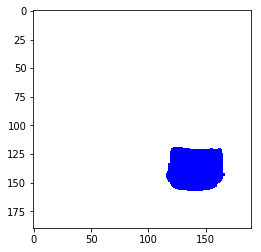

In [125]:
im = 3
c = cv2.imread(color_images[im])
c = cv2.cvtColor(c, cv2.COLOR_BGR2RGB)
t = cv2.imread(thermal_images[im])
t = cv2.cvtColor(t, cv2.COLOR_BGR2RGB)
n = cv2.imread(nir_images[im])
color, thermal, nir = crop_images(c, t, n)

cropthermal = thermal

higher_color = np.array([255, 255, 255], dtype="uint8")
lower_color = np.array([251, 219, 70], dtype="uint8")
mask = cv2.inRange(cropthermal, lower_color, higher_color)

output = cv2.bitwise_and(cropthermal, cropthermal, mask = mask)

gray = cv2.cvtColor(output, cv2.COLOR_BGR2GRAY)

mask_rgba = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGRA)

mask_rgba[np.where((mask_rgba == [0, 0, 0, 255]).all(axis = 2))] = [0, 0, 0, 0]
mask_rgba[np.where((mask_rgba == [255, 255, 255, 255]).all(axis = 2))] = [0, 0, 255, 255]

plt.imshow(mask_rgba)
plt.show()

In [ ]:
if (len(color_images) == len(thermal_images) == len(nir_images)):
    checked = True
else:
    print ("SOME IMAGE IS MISSING: lenght of the color, nir and thermal is different")
    checked = False
    
calib_data_path = 'data/KeioNIRCT/calibrationData/video_11121459/'
calib_color_path = calib_data_path+"color/"
calib_thermal_path = calib_data_path+"thermal/"
calib_nir_path = calib_data_path+"nir/"

calib_color_images = []
calib_thermal_images = []
calib_nir_images = []

for image in glob.glob(calib_color_path+"*.png"):
    calib_color_images.append(image)
calib_color_images = sorted(calib_color_images)

for image in glob.glob(calib_thermal_path+"*.png"):
    calib_thermal_images.append(image)
calib_thermal_images = sorted(calib_thermal_images)

for image in glob.glob(calib_nir_path+"*.png"):
    calib_nir_images.append(image)
calib_nir_images = sorted(calib_nir_images)

calibrated_color = []
calibrated_thermal = []
calibrated_nir = []

for im in range(len(calib_color_images)):
    c = cv2.imread(calib_color_images[im])
    c = cv2.cvtColor(c, cv2.COLOR_BGR2RGB)
    t = cv2.imread(calib_thermal_images[im])
    t = cv2.cvtColor(t, cv2.COLOR_BGR2RGB)
    n = cv2.imread(calib_nir_images[im])
    color, thermal, nir = crop_images_calib(c, t, n)
                
    calibrated_color.append(color)
    calibrated_thermal.append(thermal)
    calibrated_nir.append(nir)  
    
color_params = []
thermal_params = []
nir_params = []    
color_params   = getCalibrationParameters("color", calibrated_color)
thermal_params = getCalibrationParameters("thermal", calibrated_thermal)
nir_params     = getCalibrationParameters("nir", calibrated_nir)

masktype = "full"

if checked:
    listrange = len(color_images)
    results = []
    for im in range(listrange):
        c = cv2.imread(color_images[im])
        c = cv2.cvtColor(c, cv2.COLOR_BGR2RGB)
        t = cv2.imread(thermal_images[im])
        t = cv2.cvtColor(t, cv2.COLOR_BGR2RGB)
        n = cv2.imread(nir_images[im])
        color, thermal, nir = crop_images(c, t, n)
        
        maskresult = applymask(color, thermal, masktype)
        
        maskresult = cv2.cvtColor(maskresult, cv2.COLOR_BGRA2BGR)
        
        result = np.concatenate((color, thermal), axis=1)
        result = np.concatenate((result, nir), axis=1)
        result =  np.concatenate((result, maskresult), axis=1)
        # TODO:
        #     - SAVE EACH CROPPED FILE
        #     - SELECT THE ONES THAT ARE OK, DELETE THE REST
        #     - APPLY SAME THING TO NEW DATASET (1000+ IMAGES)
        #     - THEN CHECK IT AGAIN
        #     - APPLY AUGMENTATION (FLIP HORIZONTALLY)
        #     - THEN DATASET WILL BE COMPLETE!
        
        #undistorted_color = undistortImage(color, color_params)
        #undistorted_thermal = undistortImage(thermal, thermal_params)
        #undistorted_nir = undistortImage(nir, nir_params)
        
        #result1 = applymask(color, thermal)
        #result2 = applymask(undistorted_color, thermal)
        
        #result = np.concatenate((color, undistorted_color), axis=1)
        
        #results.append(result)
        plt.imshow(result)
        plt.title(im)
        plt.show()

In [ ]:
def old_crop_images(color, thermal, nir):

    y = 198
    x = 428
    h = 190
    w = 190

    cropcolor = color[y:y+h, x:x+w]

    y = 150
    x = 210

    resizethermal = cv2.resize(thermal,(570, 428))
    cropthermal = resizethermal[y:y+h, x:x+w]

    resizenir = cv2.resize(nir, (190, 190))
    
    return cropcolor, cropthermal, resizenir

In [1]:
import cv2
exit = False
while exit == False:
    img = cv2.imread("data/nir0000.png")
    cv2.namedWindow("preview")
    cv2.imshow("preview", img)
    k = cv2.waitKey(0)
    cv2.startWindowThread()
    if k == 113:
        print("Quit")
        cv2.destroyAllWindows()
        exit = True
    print(k)

# ESCR -> <- M R P S

27
49
Quit
113


In [2]:
lines = []
with open("data/KeioNIRCT/processed_data_3/filenames.txt") as f:
    for line in f:
        line = line.strip()
        lines.append(line)

i = 0
newList = []
filename = "newlist.txt"
thefile = open(filename, 'w')

print("Simple program to annotate filenames on images \n\n")
print("ESC   =   quit")
print("->    =   next image")
print("<-    =   previous image")
print(" M    =   annotate filename")
print(" R    =   remove from list")
print(" P    =   print(list")
print(" S    =   save list")
print("----------------------------------------------\n\n")

while True:
    imgname = lines[i]
    print(imgname)
    try:
        im = cv2.imread("data/KeioNIRCT/processed_data_3/"+imgname)
        cv2.imshow('image',im)
        k = cv2.waitKey(0)
        cv2.startWindowThread()
    except:
        print("!!                           Error!!")
        if len(newList) > 0:
            print("                         Saving list...")
            for item in newList:
                thefile.write("%s\n" % item)
            print("                             List saved as "+filename)
        break

    if k==27:    # Esc key to stop
        break
    elif k==-1:  # normally -1 returned,so don't print(it)
        continue
    elif k==109:  # M to move to another list
        if not imgname in newList:
            print("                             Moving "+imgname+" to newList")
            newList.append(imgname)
        else:
            print("                             File already in newList")
        continue
    elif k==114:  # R to remove from newList
        try:
            newList.remove(imgname)
            print("                             Removing "+imgname+" from newList")
        except:
            print("                             newList doesnt contain the file")
        continue
    elif k==112:  # P to print(list)
        print("\n\nPrinting newList:\n")
        for x in newList:
            print(x)
        print("---------------------\n\n")
        continue
    elif k==115:  # S to save
        print("                             Saving list...")
        for item in newList:
            thefile.write("%s\n" % item)
        print("                             List saved as "+filename)
        continue
    elif k==83:  # -> to skip to the next image
        if i+1 <= len(lines)-1:
            i += 1
            imgname = lines[i]
        continue
    elif k==81:  # <- to skip to the previous image
        if i-1 >= 0:
            i -= 1
            imgname = lines[i]
        continue
    else:
        print(k) # else print(its value)
        continue

cv2.destroyAllWindows()

Simple program to annotate filenames on images 


ESC   =   quit
->    =   next image
<-    =   previous image
 M    =   annotate filename
 R    =   remove from list
 P    =   print(list
 S    =   save list
----------------------------------------------


contour_0000.png
contour_0001.png
contour_0002.png
contour_0003.png
contour_0004.png
contour_0005.png
contour_0006.png
contour_0007.png
contour_0008.png
contour_0009.png
contour_0010.png
contour_0009.png
                             Moving contour_0009.png to newList
contour_0009.png
contour_0010.png
                             Moving contour_0010.png to newList
contour_0010.png
contour_0011.png
                             Moving contour_0011.png to newList
contour_0011.png
contour_0012.png
                             Moving contour_0012.png to newList
contour_0012.png
contour_0013.png
                             Moving contour_0013.png to newList
contour_0013.png
contour_0014.png
                             Moving contour_0014.p

contour_0107.png
                             Moving contour_0107.png to newList
contour_0107.png
contour_0108.png
                             Moving contour_0108.png to newList
contour_0108.png
contour_0109.png
                             Moving contour_0109.png to newList
contour_0109.png
contour_0110.png
                             Moving contour_0110.png to newList
contour_0110.png
contour_0111.png
                             Moving contour_0111.png to newList
contour_0111.png
contour_0112.png
                             Moving contour_0112.png to newList
contour_0112.png
contour_0113.png
                             Moving contour_0113.png to newList
contour_0113.png
contour_0114.png
                             Moving contour_0114.png to newList
contour_0114.png
contour_0115.png
                             Moving contour_0115.png to newList
contour_0115.png
contour_0116.png
                             Moving contour_0116.png to newList
contour_0116.png
contour_0117.png
   

contour_0196.png
                             Removing contour_0196.png from newList
contour_0196.png
contour_0195.png
                             Removing contour_0195.png from newList
contour_0195.png
contour_0194.png
                             Removing contour_0194.png from newList
contour_0194.png
contour_0193.png
                             Removing contour_0193.png from newList
contour_0193.png
contour_0194.png
contour_0195.png
contour_0196.png
contour_0197.png
contour_0198.png
contour_0199.png
contour_0200.png
contour_0201.png
contour_0202.png
contour_0203.png
contour_0204.png
contour_0205.png
contour_0206.png
contour_0207.png
contour_0208.png
contour_0209.png
contour_0210.png
contour_0211.png
contour_0210.png
                             Moving contour_0210.png to newList
contour_0210.png
contour_0211.png
                             Moving contour_0211.png to newList
contour_0211.png
contour_0212.png
                             Moving contour_0212.png to newList
contour_0

                             Saving list...
                             List saved as newlist.txt
contour_0292.png


In [22]:
from random import shuffle

d = []

for i in range(0,99):
    d.append(i)

print(d)
shuffle(d)
print(d)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98]
[87, 30, 59, 57, 15, 90, 64, 89, 23, 95, 39, 0, 51, 16, 42, 65, 17, 43, 4, 82, 24, 60, 88, 14, 69, 78, 25, 77, 29, 49, 18, 13, 67, 76, 33, 5, 37, 10, 62, 54, 8, 55, 96, 70, 98, 83, 11, 94, 63, 68, 6, 3, 35, 19, 71, 1, 26, 91, 66, 28, 73, 47, 38, 48, 44, 53, 50, 22, 7, 93, 12, 84, 20, 41, 36, 34, 85, 75, 9, 79, 21, 27, 81, 97, 52, 74, 32, 72, 92, 61, 86, 31, 40, 2, 46, 58, 80, 45, 56]


In [17]:
import os, cv2
import numpy as np

datapaths = ["./data/KeioNIRCT/data_1/", "./data/KeioNIRCT/data_2/", "./data/KeioNIRCT/data_3/", "./data/KeioNIRCT/data_4/"]

print("Flipping and saving images...")
for data in datapaths:
    filelist = []
    print(data)
    for imagepath in os.listdir(data):
        img = cv2.imread(data+imagepath, cv2.IMREAD_UNCHANGED)
        img = np.fliplr(img)
        #if "ground_truth" in imagepath:
        #    img = cv2.cvtColor(img, cv2.COLOR_RGB2RGBA)
        cv2.imwrite(data[:-1]+"_flipped/"+imagepath, img)
        
            
print("Done.")    

Flipping and saving images...
./data/KeioNIRCT/data_1/
./data/KeioNIRCT/data_2/
./data/KeioNIRCT/data_3/
./data/KeioNIRCT/data_4/
Done.


In [44]:
datapaths = ["data_1/", "data_2/", 
             "data_3/", "data_4/",
            "data_1_flipped/", "data_2_flipped/",
            "data_3_flipped/", "data_4_flipped/"]

root = "./data/KeioNIRCT/"

color = "color_"
ground_truth = "ground_truth_"
thermal = "thermal_"
nir = "nir_"
contour = "contour_"

imgtypes = [color, ground_truth, thermal, nir, contour]

for data in datapaths:
    x = []
    for imagepath in os.listdir(root+data):
        if "color" in imagepath:
            x.append(imagepath[6:])
    
    print(data, len(x))
    
    shuffle(x)
    
    train = x[0 : int(len(x) * .80)]
    test = x[int(len(x) * .80) : len(x)]

    print("    ", len(train), len(test))
    
    for trainimage in train:
        for imgtype in imgtypes:
            path = root+data+imgtype+trainimage
            img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
            path = root+"training/"+data+imgtype+trainimage
            cv2.imwrite(path, img)
    
    for testimage in test:
        for imgtype in imgtypes:
            path = root+data+imgtype+testimage
            img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
            path = root+"testing/"+data+imgtype+testimage
            cv2.imwrite(path, img)
        

data_1/ 334
     267 67
data_2/ 296
     236 60
data_3/ 120
     96 24
data_4/ 1067
     853 214
data_1_flipped/ 334
     267 67
data_2_flipped/ 296
     236 60
data_3_flipped/ 120
     96 24
data_4_flipped/ 1067
     853 214


In [52]:
img1 = cv2.imread("data/ground_truth0272.png", cv2.IMREAD_UNCHANGED)
img2 = cv2.imread("data/ground_truth_0048.png", cv2.IMREAD_UNCHANGED)

for i in img1:
    for j in i:
        if j.sum() != 0: print(j)

            
for i in img2:
    for j in i:
        if j.sum() != 0: print(j)

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0   0 255]
[255   0  

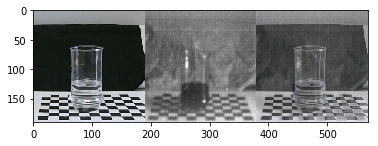

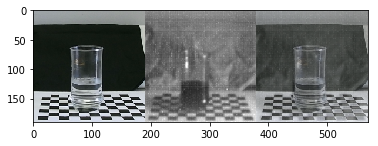

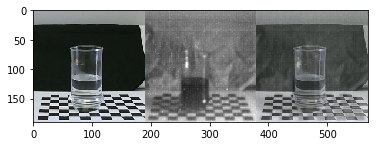

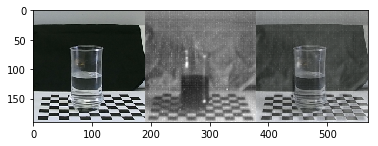

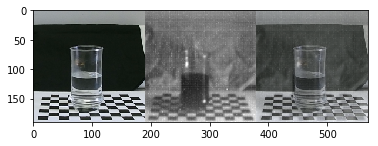

...

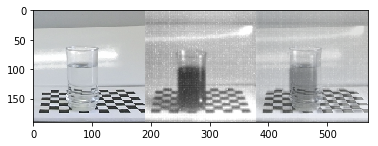

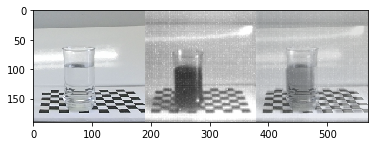

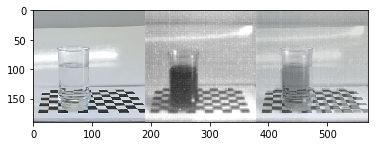

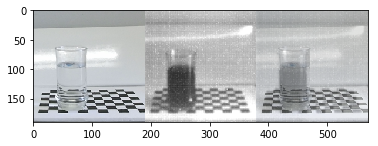

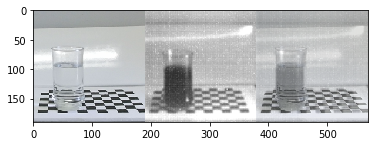

KeyboardInterrupt: 

In [2]:
# TODO:
# SINCE IT IS ALMOST IMPOSSIBLE TO TRAIN ON 4D
# WE SHOULD TRY SOME OPERATIONS TO COMBINE NIR + RGB INTO A SINGLE 3D IMAGE
# SEE YOU LATER ALLIGATOR :D

data = "data/data_liquid/training/data_4/"

for image in sorted(glob.glob(data+"color_*.png")):
    
    img_id = image[-8:]
    rgb = cv2.imread(image)
    rgb = cv2.cvtColor(rgb, cv2.COLOR_RGB2BGR)
    nir = cv2.imread(data+"nir_"+img_id)
    
    #print(data+"nir_"+img_id)

    overlay = cv2.addWeighted(rgb,0.5,nir,0.5,0)
    
    result = np.concatenate((rgb, nir), axis = 1)
    result = np.concatenate((result, overlay), axis = 1)
    
    cv2.imwrite("./rgbnir_merged/"+img_id, result)

    #plt.imshow(rgb)
    #plt.show()
    #plt.imshow(nir)
    #plt.show()
    plt.imshow(result)
    plt.show()

In [13]:
import cv2
im = cv2.imread("/home/gother/gitrepos/Semantic-Segmentation-Suite/data_liquid/train/7_color_0969.png")
#assert im.shape == (191, 190, 3), "Shape is not (190, 190, 3)"
print(im.shape)

(190, 190, 3)
